In [18]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn.model_selection as ms
from sklearn import metrics
from sklearn.pipeline import Pipeline, make_pipeline
import sklearn.preprocessing as pp
import sklearn.feature_selection as fs
import sklearn.cluster as ct
import sklearn.mixture as mx
from kneed import KneeLocator
import helpers
sns.set()
%matplotlib inline
import importlib
importlib.reload(helpers)
import time
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

## MADELON

In [111]:
X_train = pd.read_hdf('data/madelon/madelon.hdf', 'X_train')
y_train = pd.read_hdf('data/madelon/madelon.hdf', 'y_train')

In [168]:
def get_gmm_scores(X, ks=None, random_state=None):
    results = {
        'k': ks if ks is not None else np.arange(1, 11),
#         'full': [],
#         'spherical': [],
#         'tied': [],
#         'diag': [],
        'BIC': []
    }
    for k in results["k"]:
#         for cov in ['full', 'spherical', 'tied', 'diag']:
        gmm = mx.GaussianMixture(n_components=k, covariance_type='full', random_state=random_state, n_init=10)
        gmm.fit(X)
        score = gmm.bic(X)
        results['BIC'].append(score)
    return results

def get_gmm_aic(X, ks=None, random_state=None):
    results = {
        'k': ks if ks is not None else np.arange(1, 11),
        'AIC': []
    }
    for k in results["k"]:
        gmm = mx.GaussianMixture(n_components=k, covariance_type='full', random_state=random_state, n_init=10)
        gmm.fit(X)
        score = gmm.aic(X)
        results['AIC'].append(score)
    return results

In [183]:
def plot_bic(gmm_results):
    data = pd.DataFrame(gmm_results)
    min_bic_index = data['BIC'].argmin()
    opt_k = data.iloc[min_bic_index]['k']
    print("Min BIC", data.iloc[min_bic_index])
    sns.lineplot(x='k', y='BIC', data=data)
    plt.vlines(opt_k, plt.ylim()[0], plt.ylim()[1], linestyles='dashed')
    plt.title('K vs BIC')
    plt.show()

def plot_aic(gmm_results):
    data = pd.DataFrame(gmm_results)
    max_aic_index = data['AIC'].argmax()
    opt_k = int(data.iloc[max_aic_index]['k'])
    print("Max AIC", data.iloc[max_aic_index])
    sns.lineplot(x='k', y='AIC', data=data)
    plt.vlines(opt_k, plt.ylim()[0], plt.ylim()[1], linestyles='dashed')
    plt.title('K vs AIC')
    plt.show()

In [149]:
start = time.time()
gmm_scores = get_gmm_scores(X_train.values, ks=np.arange(1, 15), random_state=1)
stop = time.time()
print("Took %d s" % (stop - start))

Took 116 s


Min BIC k      1.000000e+01
BIC    6.688488e+06
Name: 9, dtype: float64


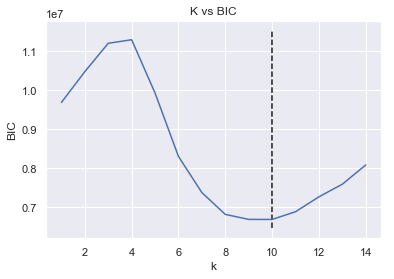

In [184]:
plot_bic(gmm_scores)

In [126]:
pd.DataFrame(gmm_scores)

,k,BIC
0,1,9.691284e+06
1,2,1.048257e+07
2,3,1.122000e+07
3,4,1.133893e+07
4,5,9.937282e+06
5,6,8.432957e+06
6,7,7.571454e+06
7,8,6.845480e+06
8,9,6.838406e+06
9,10,6.688488e+06


In [151]:
def gmm_experiment(X, k, covariance='full', random_state=None, thresh=150, feature_names=None):
    gmm = mx.GaussianMixture(n_components=k, covariance_type=covariance, random_state=random_state)
    gmm.fit(X)
    y = gmm.predict(X)
    centers = gmm.means_
    features = helpers.find_cluster_features(centers, thresh=thresh)
    print("Features", features)
    print("Unique features", sorted(list(set(features))))
    helpers.plot_cluster_features(X, y, centers, list(set(features)), feature_names=feature_names)

### Experiment with 10 clusters

Features [64, 105, 336, 338, 475, 64, 153, 336, 453, 493, 105, 64, 105, 153, 336, 64, 105, 336, 338, 455, 64, 153, 336, 153, 453, 455, 493, 153, 338, 453, 493, 153, 493, 153, 338, 442, 105, 153, 336, 338, 442, 338, 442, 453, 475, 493, 105, 153, 453, 493, 493, 105, 153, 453, 455, 493, 442, 453, 493, 153, 442, 453, 493, 153, 64, 153, 336, 493, 336, 153, 105, 153, 338, 453, 493, 453, 493, 153, 453, 493, 64, 105, 336, 338, 455, 64, 153, 336, 453, 493, 105, 153, 336, 105, 153, 338, 64, 105, 153, 336, 338, 453, 455, 493, 105, 105, 453, 455, 493, 105, 153, 453, 493, 153, 338, 442, 105, 153, 453, 455, 493, 338, 442, 442, 453, 455, 493]
Unique features [64, 105, 153, 336, 338, 442, 453, 455, 475, 493]


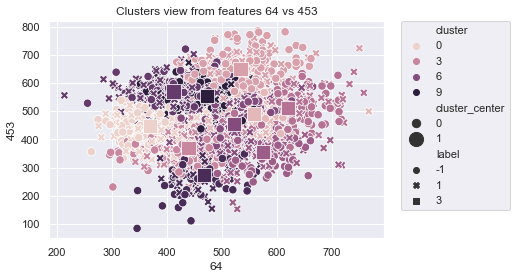

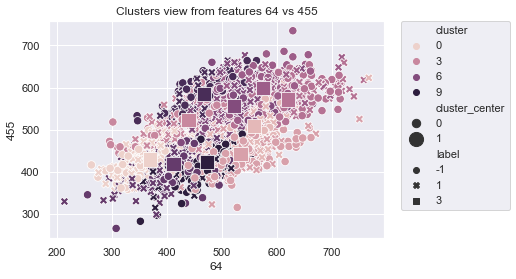

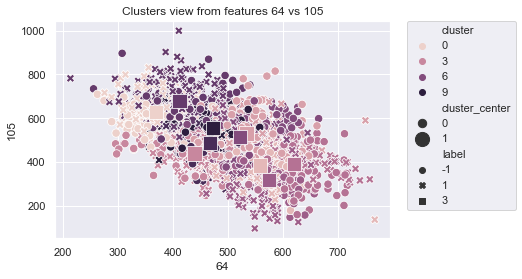

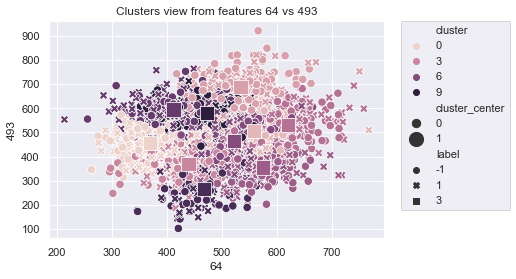

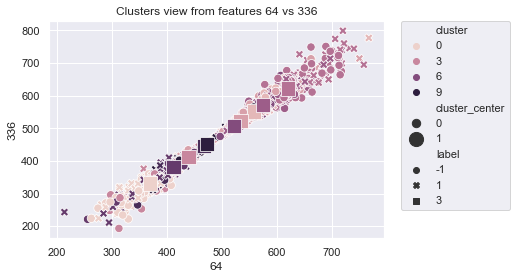

...

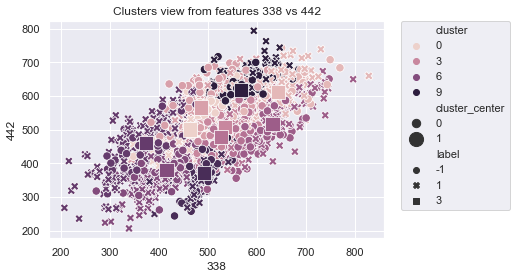

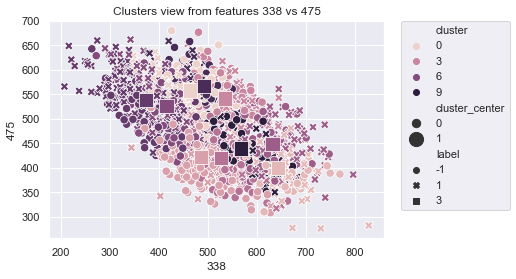

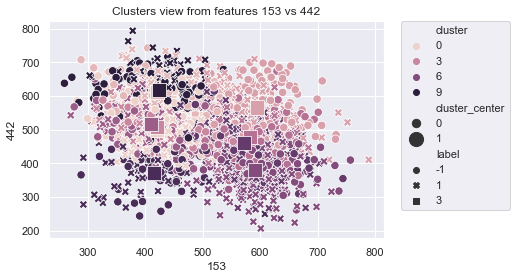

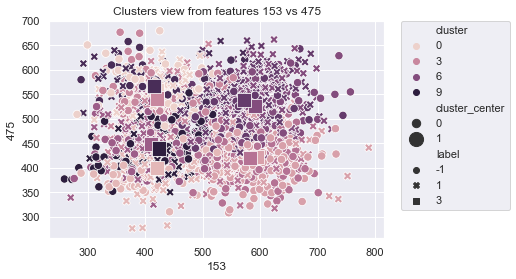

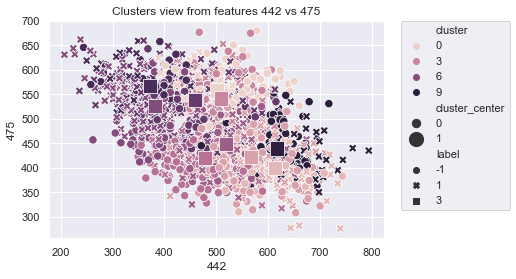

   cluster  negative  positive  pos_over_neg  total   pct_neg   pct_pos  \
0        0        75       110      1.466667    185  0.071225  0.107108   
1        1        63        96      1.523810    159  0.059829  0.093476   
2        2       170        81      0.476471    251  0.161443  0.078870   
3        3       115        92      0.800000    207  0.109212  0.089581   
4        4       150        65      0.433333    215  0.142450  0.063291   
5        5        96        84      0.875000    180  0.091168  0.081792   
6        6       103       197      1.912621    300  0.097816  0.191821   
7        7        98       189      1.928571    287  0.093067  0.184031   
8        8        55        56      1.018182    111  0.052232  0.054528   
9        9       128        57      0.445312    185  0.121557  0.055501   

   pct_total  
0   0.088942  
1   0.076442  
2   0.120673  
3   0.099519  
4   0.103365  
5   0.086538  
6   0.144231  
7   0.137981  
8   0.053365  
9   0.088942  


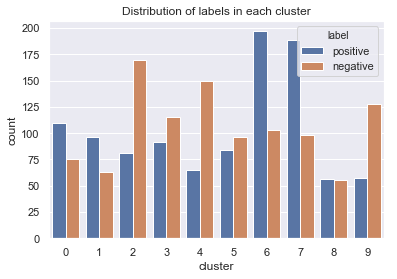

In [185]:
importlib.reload(helpers)
helpers.gmm_experiment(X_train, y_train, 10)

### Experiment with 8 clusters

Features [442, 453, 493, 153, 105, 153, 338, 453, 493, 153, 453, 493, 105, 153, 336, 453, 493, 153, 338, 442, 105, 153, 338, 442, 153, 105, 453, 493, 153, 442, 105, 493, 442, 453, 493, 153, 336, 105, 153, 338, 442, 153, 64, 105, 153, 336, 338, 453, 455, 493, 64, 105, 336, 64, 153, 336, 453, 493, 105, 153, 338, 453, 493, 493, 64, 105, 336, 338, 64, 105, 153, 336, 153]
Unique features [64, 105, 153, 336, 338, 442, 453, 455, 493]


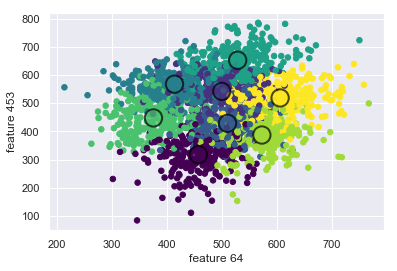

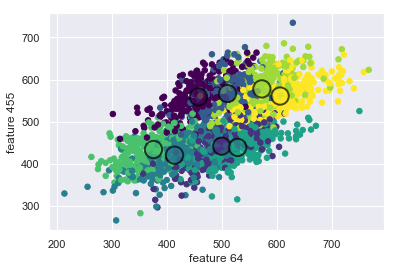

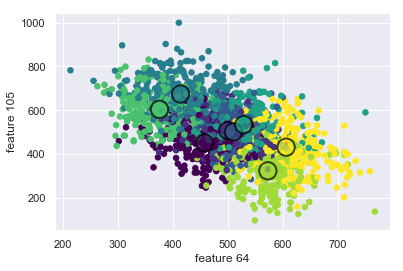

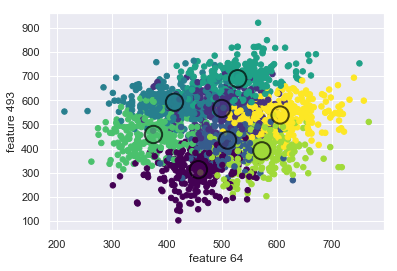

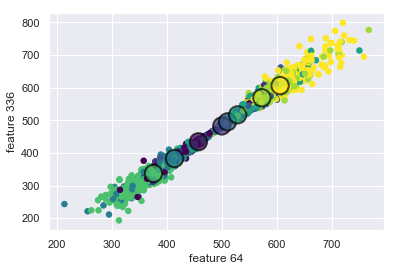

...

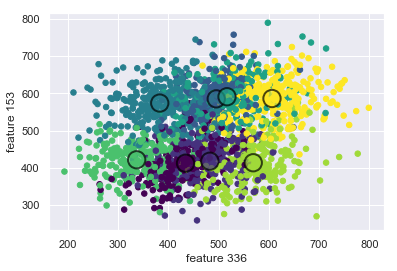

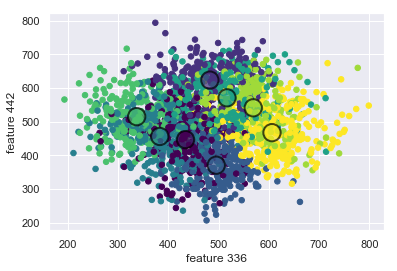

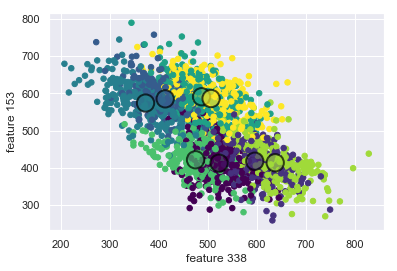

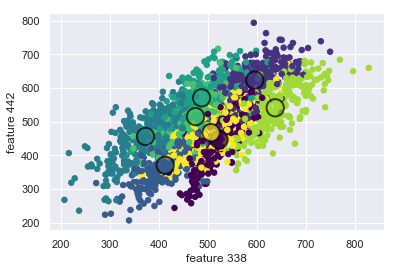

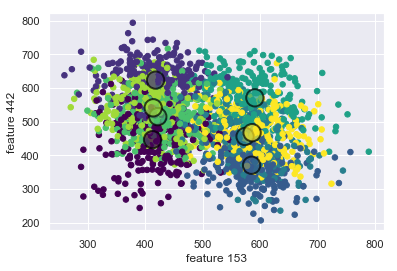

In [76]:
gmm_experiment(X_train.values, 8)

### Experiment with 10 clusters

Features [153, 442, 453, 493, 105, 336, 442, 442, 453, 493, 64, 153, 336, 453, 493, 453, 493, 153, 105, 153, 453, 493, 442, 105, 153, 338, 453, 455, 493, 153, 153, 453, 493, 64, 153, 336, 453, 493, 442, 453, 493, 105, 153, 453, 493, 105, 455, 493, 105, 153, 64, 105, 336, 338, 455, 105, 153, 338, 442, 64, 105, 153, 336, 338, 453, 455, 493, 336, 442, 493, 153, 336, 153, 338, 442, 105, 153, 338, 442, 453, 493, 153, 336, 153, 105, 153, 338, 453, 493, 64, 105, 153, 336, 64, 105, 336, 338, 64, 153, 336, 493, 153, 442, 153, 105, 105, 453, 493, 153, 338, 442, 105, 153, 338, 453, 493]
Unique features [64, 105, 153, 336, 338, 442, 453, 455, 493]


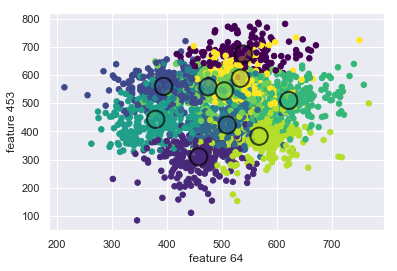

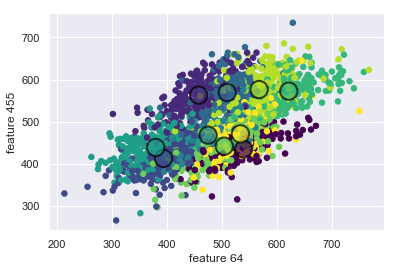

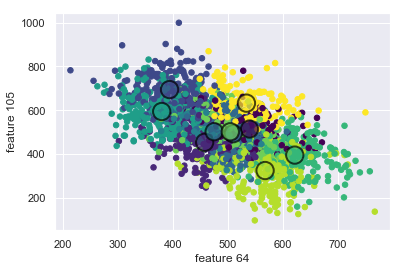

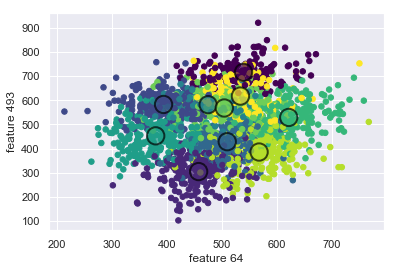

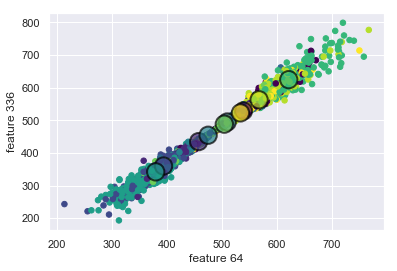

...

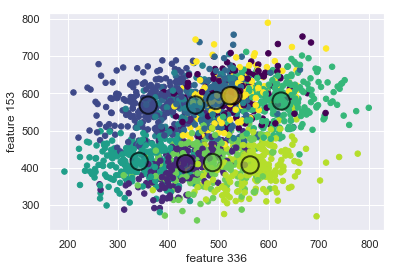

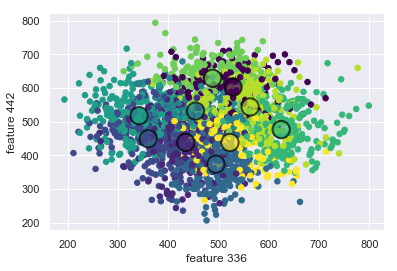

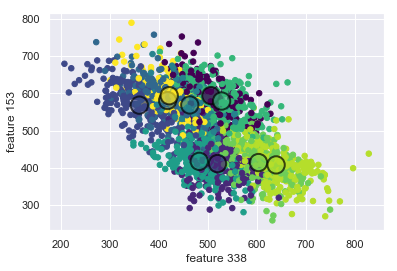

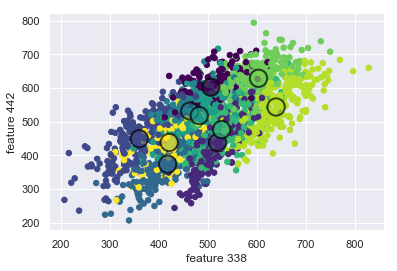

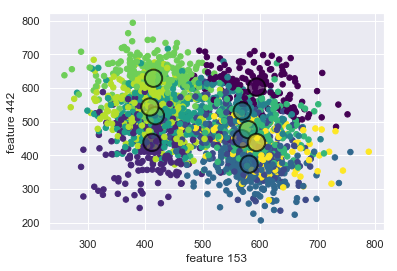

In [77]:
gmm_experiment(X_train.values, 10)

## TELCO

In [156]:
telX_train = pd.read_hdf('data/telco/telco.hdf', 'X_train')
tely_train = pd.read_hdf('data/telco/telco.hdf', 'y_train')
telX_scaled = pp.scale(telX_train)

In [157]:
start = time.time()
tel_results = get_gmm_scores(telX_scaled, ks=np.arange(1, 15), random_state=1)
stop = time.time()
print("Took", stop-start, "s")

Took 28.324366092681885 s


Min BIC k          14.000000
BIC   -478860.582441
Name: 13, dtype: float64


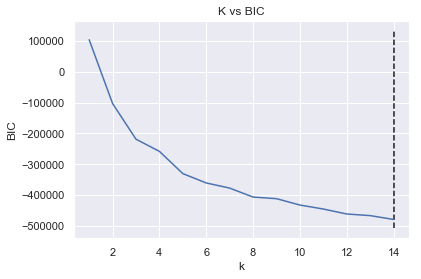

In [187]:
plot_bic(tel_results)

## Experiment with 4 clusters

Features [11, 12, 13, 14, 17, 18, 24, 4, 7, 8, 9, 10, 11, 12, 14, 15, 16, 18, 5, 16, 18, 4, 7, 10, 16, 17, 19, 21, 5, 14, 16, 17, 4, 5, 14, 15, 19, 21]
Unique features [4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 24]


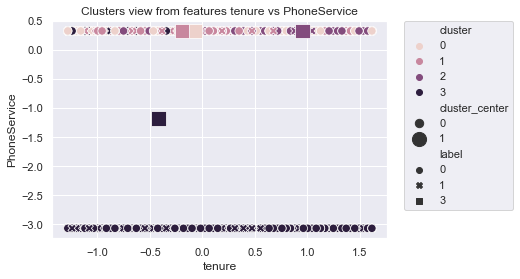

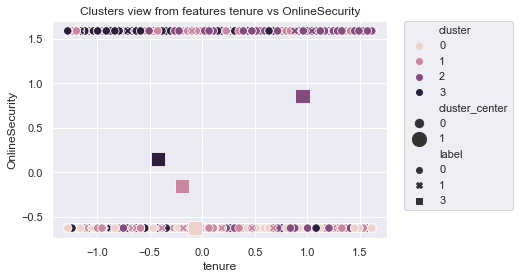

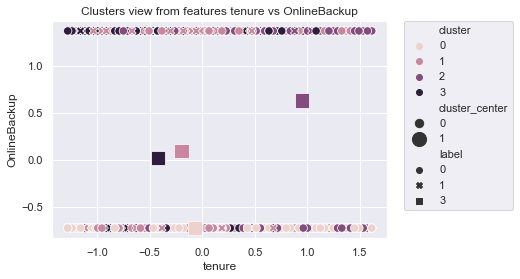

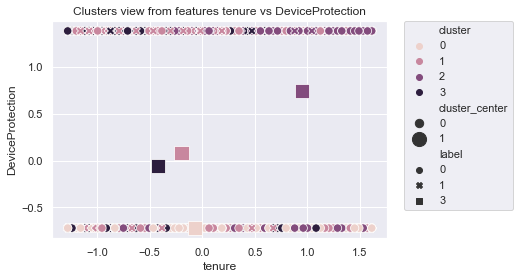

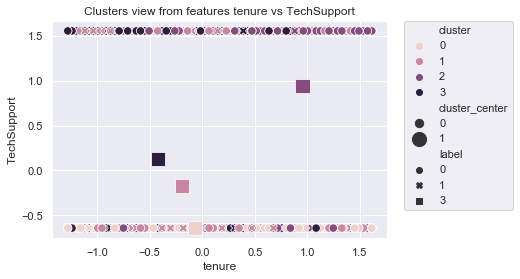

...

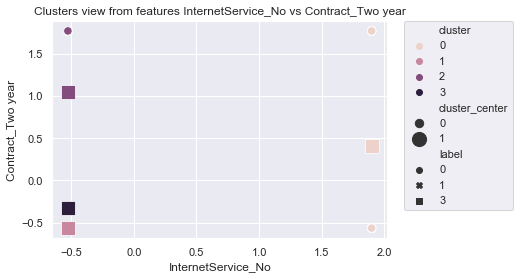

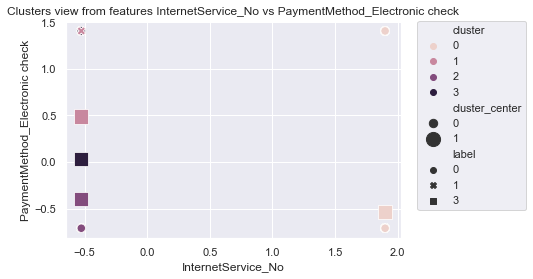

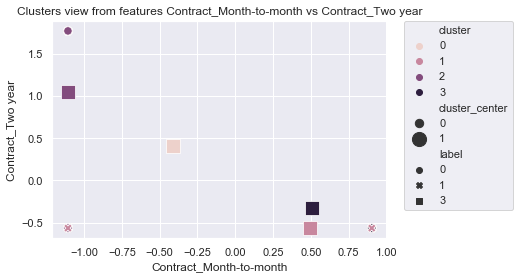

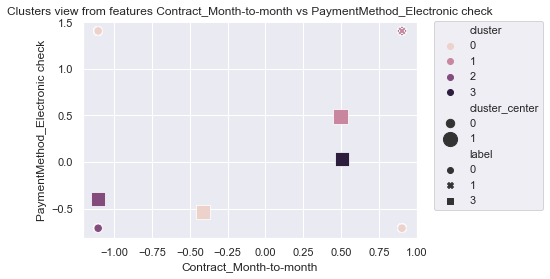

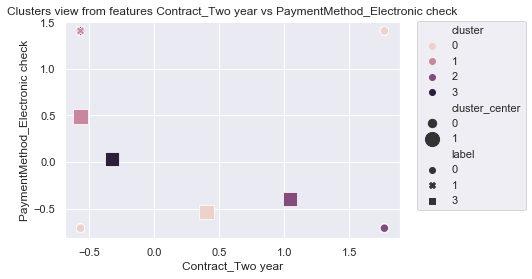

   cluster  negative  positive  pos_over_neg  total   pct_neg   pct_pos  \
0        0      1135        86      0.075771   1221  0.274818  0.057525   
1        1      1106      1022      0.924051   2128  0.267797  0.683612   
2        2      1000        58      0.058000   1058  0.242131  0.038796   
3        3       889       329      0.370079   1218  0.215254  0.220067   

   pct_total  
0   0.217067  
1   0.378311  
2   0.188089  
3   0.216533  


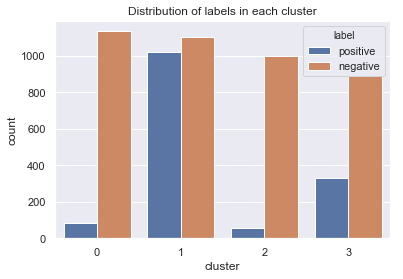

In [189]:
helpers.gmm_experiment(pd.DataFrame(telX_scaled), pd.DataFrame(tely_train.values), 4, thresh=1, feature_names=telX_train.columns,
              neg_val=0)

### Experiment with 13 clusters

Features [4, 5, 6, 14, 15, 16, 17, 19, 20, 5, 16, 18, 5, 6, 11, 12, 14, 16, 17, 5, 5, 16, 18, 19, 21, 4, 5, 6, 14, 15, 16, 17, 19, 21, 1, 5, 6, 14, 16, 17, 4, 5, 6, 7, 10, 14, 15, 19, 21, 5, 19, 20, 5, 14, 16, 17, 5, 16, 18, 19, 20, 5, 4, 6, 8, 9, 11, 12, 14, 15, 17, 18, 19, 20, 25, 19, 20, 4, 14, 15, 16, 17, 19, 20, 8, 9, 11, 12, 14, 15, 17, 18, 20, 21, 20, 21, 1, 4, 15, 19, 20, 16, 17, 20, 21, 14, 15, 16, 17, 4, 15, 19, 20, 6, 8, 9, 11, 12, 14, 15, 17, 18, 4, 11, 12, 14, 15, 16, 17, 19, 20, 6, 9, 11, 12, 13, 14, 15, 17, 18, 24, 25, 14, 16, 18, 25, 4, 19, 21, 4, 6, 7, 8, 9, 10, 11, 12, 14, 15, 17, 18, 19, 21, 25, 1, 6, 11, 12, 13, 14, 17, 18, 24, 25, 4, 7, 8, 9, 10, 11, 12, 14, 15, 16, 18, 19, 21, 25, 4, 7, 8, 9, 10, 14, 15, 16, 18, 19, 20, 14, 17, 18, 25, 19, 20, 14, 16, 18, 6, 11, 12, 14, 16, 17, 24, 6, 9, 11, 12, 13, 14, 17, 18, 19, 21, 24, 4, 10, 15, 19, 21, 1, 4, 7, 10, 16, 17, 19, 21, 24, 6, 11, 14, 16, 17, 19, 20, 24, 11, 12, 6, 9, 11, 12, 13, 14, 15, 17, 18, 19, 20, 24, 25, 6,

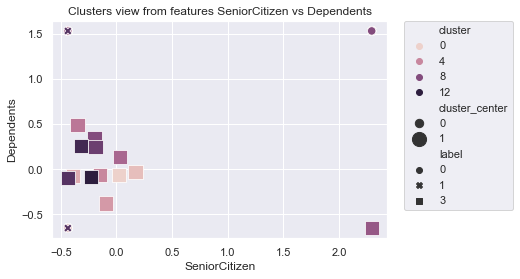

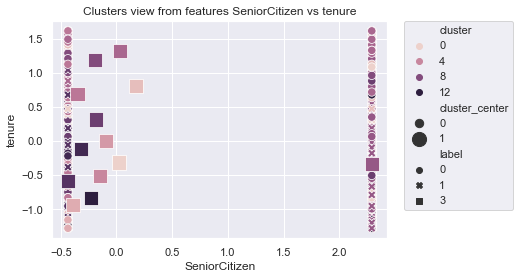

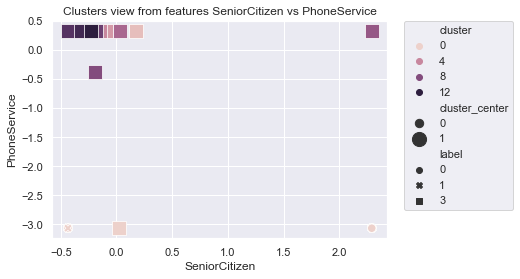

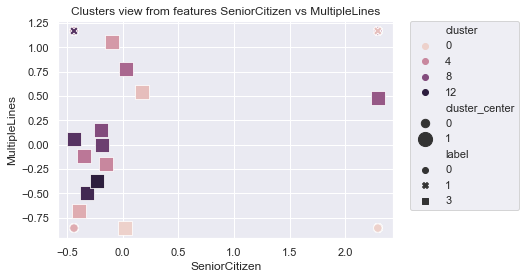

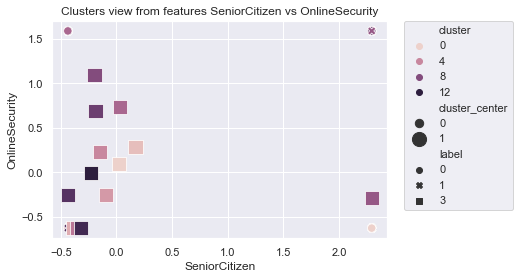

...

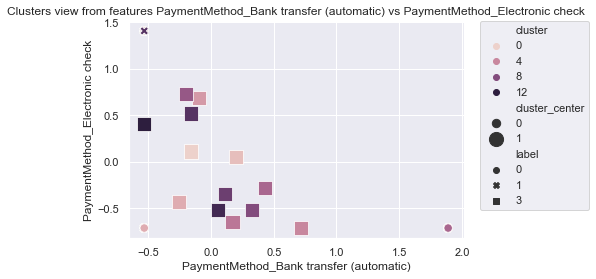

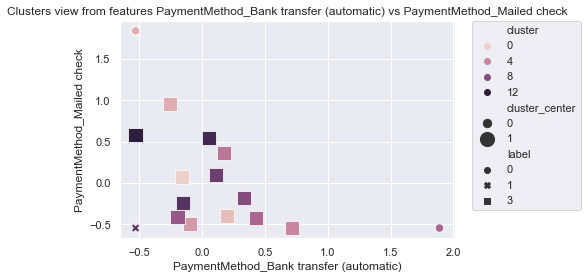

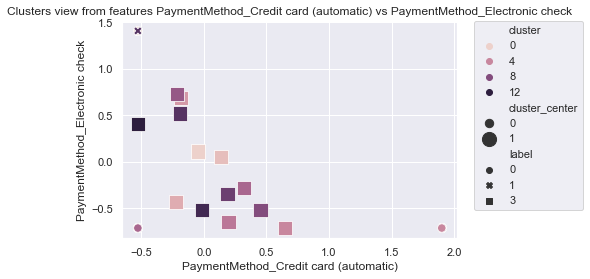

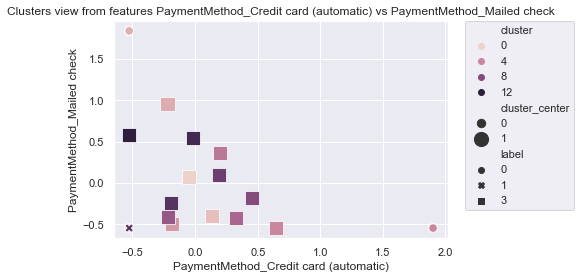

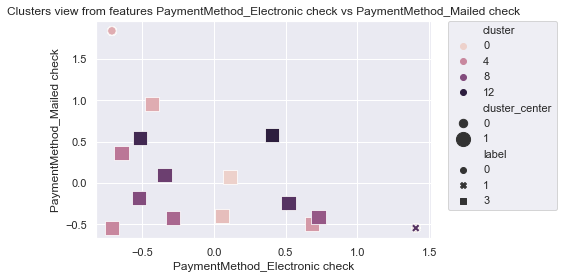

    cluster  negative  positive  pos_over_neg  total   pct_neg   pct_pos  \
0         0       306       135      0.441176    441  0.074092  0.090301   
1         1       345        86      0.249275    431  0.083535  0.057525   
2         2       343        78      0.227405    421  0.083051  0.052174   
3         3        88       113      1.284091    201  0.021308  0.075585   
4         4       177        40      0.225989    217  0.042857  0.026756   
5         5       504         2      0.003968    506  0.122034  0.001338   
6         6       329        22      0.066869    351  0.079661  0.014716   
7         7       202       276      1.366337    478  0.048910  0.184615   
8         8       470         8      0.017021    478  0.113801  0.005351   
9         9       300        29      0.096667    329  0.072639  0.019398   
10       10       471       547      1.161359   1018  0.114044  0.365886   
11       11       288         6      0.020833    294  0.069734  0.004013   
12       12 

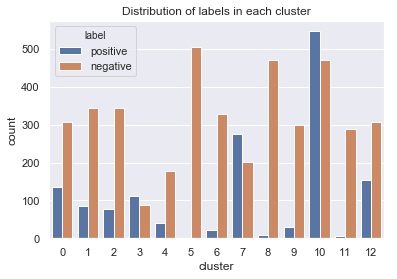

In [162]:
helpers.gmm_experiment(pd.DataFrame(telX_scaled), pd.DataFrame(tely_train.values), 13, thresh=1, feature_names=telX_train.columns,
              neg_val=0)

Max AIC k           1.000000
AIC    101046.486252
Name: 0, dtype: float64


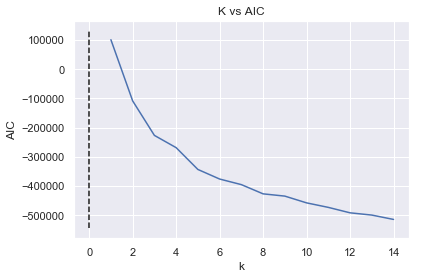

In [171]:
# start = time.time()
# tel_aic_results = get_gmm_aic(telX_scaled, ks=np.arange(1, 15), random_state=1)
# stop = time.time()
# print("Took", stop-start, "s")
plot_aic(tel_aic_results)

In [182]:
int(pd.DataFrame(tel_results).iloc[13]['k'])

14